In [0]:
!nvidia-smi

Sat Jun 29 18:22:41 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 418.67       Driver Version: 410.79       CUDA Version: 10.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8    15W /  70W |      0MiB / 15079MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
import random
import torch
from pathlib import Path
import numpy as np

import torch.nn.parallel
import torch.backends.cudnn as cudnn

In [0]:
seed = 123
random.seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.manual_seed(seed)
np.random.seed(seed)
print("My seed:", seed)

My seed: 123


In [0]:
DATA_PATH = Path('./data')
PATH = DATA_PATH / 'celeba'
PATH.mkdir(parents=True, exist_ok=True)

# Number of worker threads
workers = 2 # 2 cores available in colab

# Batch size
b_size = 128

# Spatial size of the training images. Resize to this size
image_size = 64

# Number of channels (Here it's 3 since RGB images)
nc = 3

# Size of latent vector
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epocs
num_epochs = 5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [0]:
!wget https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip 

--2019-06-29 18:22:59--  https://s3-us-west-1.amazonaws.com/udacity-dlnfd/datasets/celeba.zip
Resolving s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)... 52.219.112.72
Connecting to s3-us-west-1.amazonaws.com (s3-us-west-1.amazonaws.com)|52.219.112.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1443490838 (1.3G) [application/zip]
Saving to: ‘celeba.zip’

celeba.zip          100%[===================>]   1.34G  76.6MB/s    in 18s     

2019-06-29 18:23:18 (74.8 MB/s) - ‘celeba.zip’ saved [1443490838/1443490838]



In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!cp ./celeba.zip ./data/celeba

In [0]:
!unzip ./data/celeba/celeba.zip -d {PATH}

Archive:  ./data/celeba/celeba.zip
   creating: data/celeba/img_align_celeba/
 extracting: data/celeba/img_align_celeba/000001.jpg  
 extracting: data/celeba/img_align_celeba/000002.jpg  
 extracting: data/celeba/img_align_celeba/000003.jpg  
 extracting: data/celeba/img_align_celeba/000004.jpg  
 extracting: data/celeba/img_align_celeba/000005.jpg  
 extracting: data/celeba/img_align_celeba/000006.jpg  
 extracting: data/celeba/img_align_celeba/000007.jpg  
 extracting: data/celeba/img_align_celeba/000008.jpg  
 extracting: data/celeba/img_align_celeba/000009.jpg  
 extracting: data/celeba/img_align_celeba/000010.jpg  
 extracting: data/celeba/img_align_celeba/000011.jpg  
 extracting: data/celeba/img_align_celeba/000012.jpg  
 extracting: data/celeba/img_align_celeba/000013.jpg  
 extracting: data/celeba/img_align_celeba/000014.jpg  
 extracting: data/celeba/img_align_celeba/000015.jpg  
 extracting: data/celeba/img_align_celeba/000016.jpg  
 extracting: data/celeba/img_align_celeba/

In [0]:
from torch.utils.data import DataLoader
import torchvision.datasets as dset
import torchvision.transforms as transforms

## Creating the dataset

In [0]:
dataset = dset.ImageFolder(root=PATH,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((.5,.5,.5), (.5,.5,.5)),
                           ]))
  
dataloader = DataLoader(dataset, batch_size=b_size, 
                        shuffle=True, num_workers=workers)

In [0]:
# Important! The following line sets the device.
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [0]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vision_utils

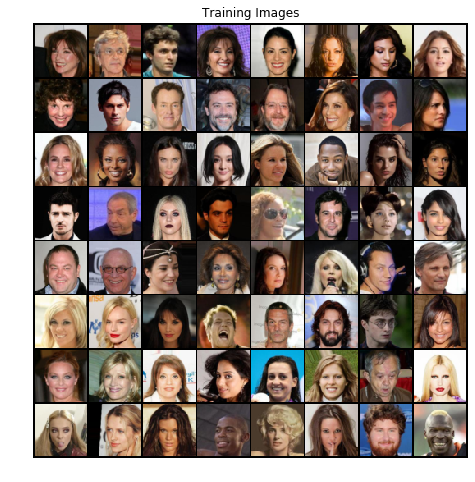

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vision_utils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
import torch.nn as nn

In [0]:
# Will be called by the Generator and Discriminator networks
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    nn.init.normal_(m.weight.data, 0., .02)
  elif classname.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1., .02)
    nn.init.constant_(m.bias.data, 0)

In [0]:
class Generator(nn.Module):
  def __init__(self, ngpu):
    super(Generator, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
      nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
      nn.BatchNorm2d(ngf * 8),
      nn.ReLU(True),
       
      nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf * 4),
      nn.ReLU(True),
        
      nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf * 2),
      nn.ReLU(True),
      
      nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ngf),
      nn.ReLU(True),
        
      nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
      nn.Tanh()
      # state size. (nc) x 64 x 64 
    )
    
  def forward(self, input):
    return self.main(input)

In [0]:
# Create the generator
random.seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.manual_seed(seed)
np.random.seed(seed)
netG = Generator(ngpu).to(device)

# In multi-gpu : Important!
if (device.type == 'cuda') and (ngpu > 1):
  netG = nn.DataParallel(netG, list(range(ngpu)))

In [0]:
netG.load_state_dict(torch.load('drive/My Drive/netG-vxbls-190000.pth'))
netG.train()

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [0]:
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
random.seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.manual_seed(seed)
np.random.seed(seed)
netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [0]:
class Critic(nn.Module):
  def __init__(self, ngpu):
    super(Critic, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
      nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 2),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 4),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
      nn.BatchNorm2d(ndf * 8),
      nn.LeakyReLU(0.2, inplace=True),
        
      nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
    )
    
  def forward(self, input):
    return self.main(input).view(-1)

In [0]:
# Create the critic
random.seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.manual_seed(seed)
np.random.seed(seed)
netC = Critic(ngpu).to(device)

# In multi-gpu : Important!
if (device.type == 'cuda') and (ngpu > 1):
  netC = nn.DataParallel(netG, list(range(ngpu)))

In [0]:
netC.load_state_dict(torch.load('drive/My Drive/netC-vxbls-190000.pth'))
netC.train()

Critic(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

In [0]:
random.seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.manual_seed(seed)
np.random.seed(seed)
netC.apply(weights_init)
print(netC)

Critic(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)


In [0]:
import torch.optim as optim

In [0]:
# Fixed batch of latent vectors for visualizing
# The dimensions are this way because remember that when we are upscaling 
# we have 128 channels with 1x1 feature map
random.seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.manual_seed(seed)
np.random.seed(seed)
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1
fake_label = 0 

tensor([[[[-1.6704]],

         [[-0.8591]],

         [[-0.7605]],

         ...,

         [[ 0.3741]],

         [[ 0.4097]],

         [[ 0.0286]]],


        [[[-2.1538]],

         [[ 0.6538]],

         [[ 0.2175]],

         ...,

         [[ 0.2141]],

         [[ 0.8854]],

         [[ 0.0246]]],


        [[[ 1.1742]],

         [[ 0.6336]],

         [[ 0.2795]],

         ...,

         [[ 1.2882]],

         [[-1.4988]],

         [[ 0.5409]]],


        ...,


        [[[ 0.6011]],

         [[-0.6939]],

         [[-0.4505]],

         ...,

         [[-1.1425]],

         [[ 0.2676]],

         [[-1.3141]]],


        [[[-1.0846]],

         [[-1.0364]],

         [[-1.0331]],

         ...,

         [[ 0.9126]],

         [[-1.3463]],

         [[ 2.7269]]],


        [[[-0.1532]],

         [[ 1.0698]],

         [[ 0.3291]],

         ...,

         [[-0.0922]],

         [[-0.0690]],

         [[-0.4788]]]], device='cuda:0')


In [0]:
# Learning rate for optimizers
lr = 4e-4

optimizerC = optim.RMSprop(netC.parameters(), lr=lr)
optimizerG = optim.RMSprop(netG.parameters(), lr=lr)

In [0]:
def get_infinite_batches(data_loader):
  while True:
      for i, (images, _) in enumerate(data_loader):
          yield images

## Random Seed Checker


In [0]:
x = np.random.randn(2,2)
y = torch.randn(2, 2, 1, 1, device=device)
print(x)
print(y)

[[-1.0856306   0.99734545]
 [ 0.2829785  -1.50629471]]
tensor([[[[-0.9290]],

         [[ 1.8618]]],


        [[[ 0.3077]],

         [[-0.6726]]]], device='cuda:0')


## Training Loop

In [0]:
from torch.autograd import Variable

In [0]:
b_size = 128

max_iters = 100000
weight_clip = 0.01
gen_iters = 2
crit_iters = 1

# Lists to keep track of progress
img_list = []
G_losses = []
C_losses_fake = []
C_losses_real = []
C_losses = []
diff_G_loss = []
diff_C_loss = []
# real_C_res = np.ndarray(max_iters * b_size + 1, dtype=np.float16)
# fake_C_res = np.ndarray(max_iters * b_size + 1, dtype=np.float16)

one = torch.FloatTensor([1])
mone = one * -1
one = one.cuda()
m_one = mone.cuda()

In [0]:
Tensor = torch.cuda.FloatTensor
target_real = Variable(Tensor(b_size).fill_(1.), requires_grad=False)
target_fake = Variable(Tensor(b_size).fill_(0.), requires_grad=False)

In [0]:
data = get_infinite_batches(dataloader)

Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/queues.py", line 240, in _feed
    send_bytes(obj)
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.6/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe


## Regularising Factor


In [0]:
# Regularising Factor
def alpha(it, maxIters, maxAlpha):
  return 0.0

In [0]:
# Testing Regularising Factor
test = []
for i in range(60000):
  test.append(alpha(i, 60000, 0.3))

plt.figure(figsize=(20,10))
plt.title("Regularising Factor vs iterations")
plt.plot(test)
plt.xlabel("Regularising Factor")
plt.ylabel("Loss")
plt.legend()
plt.show()

## Random Seed Checker 2


In [0]:
x = np.random.randn(2,2)
y = torch.randn(2, 2, 1, 1, device=device)
print(x)
print(y)

[[ 1.26593626 -0.8667404 ]
 [-0.67888615 -0.09470897]]
tensor([[[[ 0.7461]],

         [[-0.8988]]],


        [[[-2.1350]],

         [[-0.2558]]]], device='cuda:0')


In [0]:
import os
import shutil

[50/100000]	Loss_C: 0.7526	Loss_C_fake: 0.2964	Loss_C_real: 0.4562	Loss_G: 0.3055	 alpha: 0.0000
[100/100000]	Loss_C: 0.3464	Loss_C_fake: 0.1174	Loss_C_real: 0.2290	Loss_G: 0.8665	 alpha: 0.0000
[150/100000]	Loss_C: 0.4741	Loss_C_fake: 0.0625	Loss_C_real: 0.4116	Loss_G: 0.0996	 alpha: 0.0000
[200/100000]	Loss_C: 0.3685	Loss_C_fake: 0.2116	Loss_C_real: 0.1569	Loss_G: 0.1408	 alpha: 0.0000
[250/100000]	Loss_C: 0.9265	Loss_C_fake: 0.0710	Loss_C_real: 0.8555	Loss_G: 0.0973	 alpha: 0.0000
[300/100000]	Loss_C: 0.4775	Loss_C_fake: 0.3962	Loss_C_real: 0.0813	Loss_G: 0.6264	 alpha: 0.0000
[350/100000]	Loss_C: 0.4890	Loss_C_fake: 0.2269	Loss_C_real: 0.2621	Loss_G: 0.1995	 alpha: 0.0000
[400/100000]	Loss_C: 0.5615	Loss_C_fake: 0.0268	Loss_C_real: 0.5348	Loss_G: 0.0349	 alpha: 0.0000
[450/100000]	Loss_C: 0.5018	Loss_C_fake: 0.4350	Loss_C_real: 0.0668	Loss_G: 0.5360	 alpha: 0.0000
[500/100000]	Loss_C: 0.9415	Loss_C_fake: 0.6315	Loss_C_real: 0.3100	Loss_G: 0.8197	 alpha: 0.0000
[550/100000]	Loss_C: 

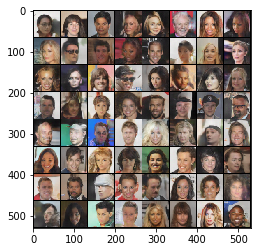

In [0]:
for i in range(1, max_iters + 1):
  
  # Since, Critic will be updated first.
  for p in netC.parameters():
    p.requires_grad = True
    
  C_loss = 0.
  for j in range(1, crit_iters + 1):
    # Update Critic network.
      
    netC.zero_grad()
        
    # Sample data from real distribution
    real_data = next(data).cuda()
    
    # Sample data from fake distribution
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake_data = netG(noise) 
    
    # Getting the outputs of Critic
    C_real = netC(real_data)
    C_fake = netC(fake_data.detach()) # To remove it from the graph
    
    # Finding the errors
    C_loss_real = 0.5 * ((C_real - 1.0)**2).mean().view(1) # mean along rows
    C_loss_real.backward()
    
    C_loss_fake = 0.5 * ((C_fake - 0.0 - alpha(i, max_iters, 0.9))**2).mean().view(1)
    C_loss_fake.backward()
    
    
    C_loss = C_loss_fake + C_loss_real # -V(D,G)
    optimizerC.step()
  
  G_loss = 0.    
  # Update Generator network.
  for p in netC.parameters():
     p.requires_grad = False  # to avoid computation

  for j in range(1, gen_iters + 1):
    # Update Generator network.
    netG.zero_grad()

    # Sample data from fake distribution
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake_data = netG(noise)

    # Finding the error
    C_G_noise = netC(fake_data)
    G_loss = 0.5 * ((C_G_noise - 1.0)**2).mean().view(1)
    G_loss.backward()
    G_cost = G_loss
    optimizerG.step()
    
  # Display Results
  if i % 50 == 0:
    print('[%d/%d]\tLoss_C: %.4f\tLoss_C_fake: %.4f\tLoss_C_real: %.4f\tLoss_G: %.4f\t alpha: %.4f'
        % (i, max_iters, C_loss.item(), C_loss_fake.item(), C_loss_real.item(), G_loss.item(), alpha(i, max_iters, 0.9)))

  # Save Losses for plotting later
  G_losses.append(G_loss.item())
  C_losses.append(C_loss.item())  
  C_losses_fake.append(C_loss_fake.item())
  C_losses_real.append(C_loss_real.item())

  # Display images
  # Check how the generator is doing by saving G's output on fixed_noise
  if (i % 1000 == 0):
    with torch.no_grad():
       fake = netG(fixed_noise).detach().cpu()
    img_list.append(vision_utils.make_grid(fake, padding=2, normalize=True))
    plt.imshow(np.transpose(vision_utils.make_grid(img_list[-1].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
    
  if i % 5000 == 0:
    torch.save(netC.state_dict(), "./netC-vxbls-{}.pth".format(i))
    torch.save(netG.state_dict(), "./netG-vxbls-{}.pth".format(i))
    shutil.copy("./netC-vxbls-{}.pth".format(i), './drive/My Drive/')
    shutil.copy("./netG-vxbls-{}.pth".format(i), './drive/My Drive/')

## Saving Values

In [0]:
np.save('vxbls-G_losses_1.npy', np.array(G_losses))
np.save('vxbls-C_losses_1.npy', np.array(C_losses))

In [0]:
shutil.copy('vxbls-G_losses_1.npy', './drive/My Drive/')
shutil.copy('vxbls-C_losses_1.npy', './drive/My Drive/')

'./drive/My Drive/vxbls-C_losses_1.npy'

In [0]:
np.save('vxbls-C_losses_fake_1.npy', np.array(C_losses_fake))
np.save('vxbls-C_losses_real_1.npy', np.array(C_losses_real))

In [0]:
shutil.copy('vxbls-C_losses_fake_1.npy', './drive/My Drive/')
shutil.copy('vxbls-C_losses_real_1.npy', './drive/My Drive/')

'./drive/My Drive/vxbls-C_losses_real_1.npy'

In [0]:
for i in range(len(img_list)):
  img_list[i] = img_list[i].numpy()

In [0]:
np.save('vxbls-img_list_1.npy', img_list)
shutil.copy('vxbls-img_list_1.npy', './drive/My Drive/')

'./drive/My Drive/vxbls-img_list_1.npy'

# Graphs

## Error graphs

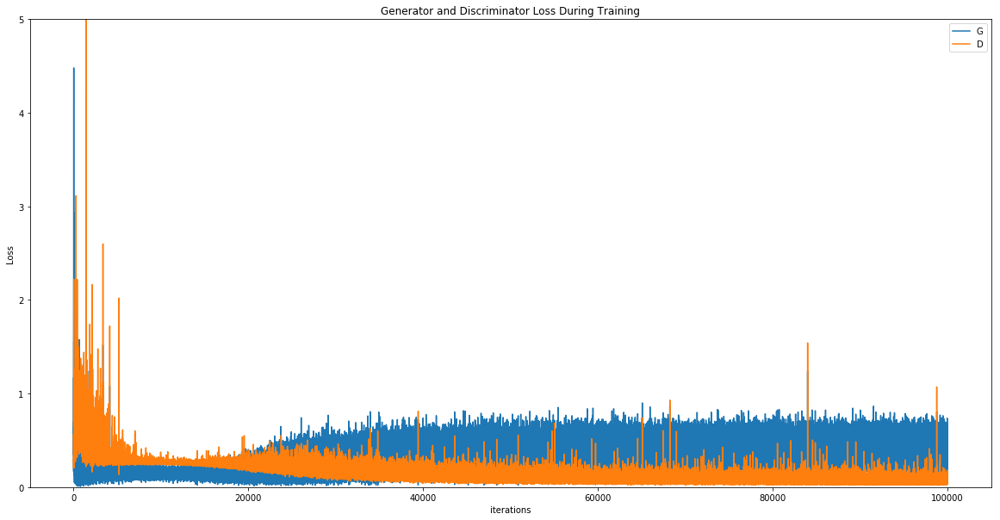

<Figure size 432x288 with 0 Axes>

In [0]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(C_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(0,5)
plt.legend()
plt.show()
plt.savefig('1.png')

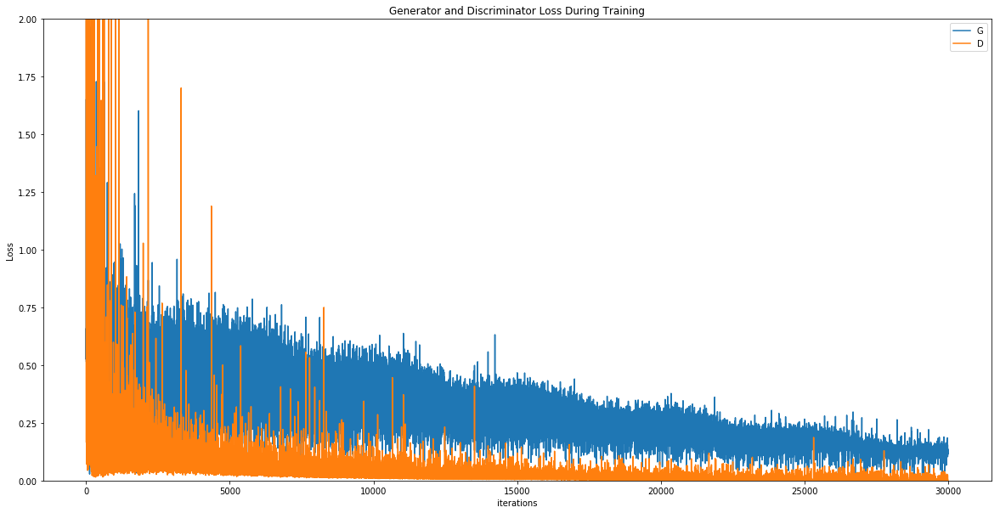

<Figure size 432x288 with 0 Axes>

In [0]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(C_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(0,2)
plt.legend()
plt.show()
plt.savefig('1.png')

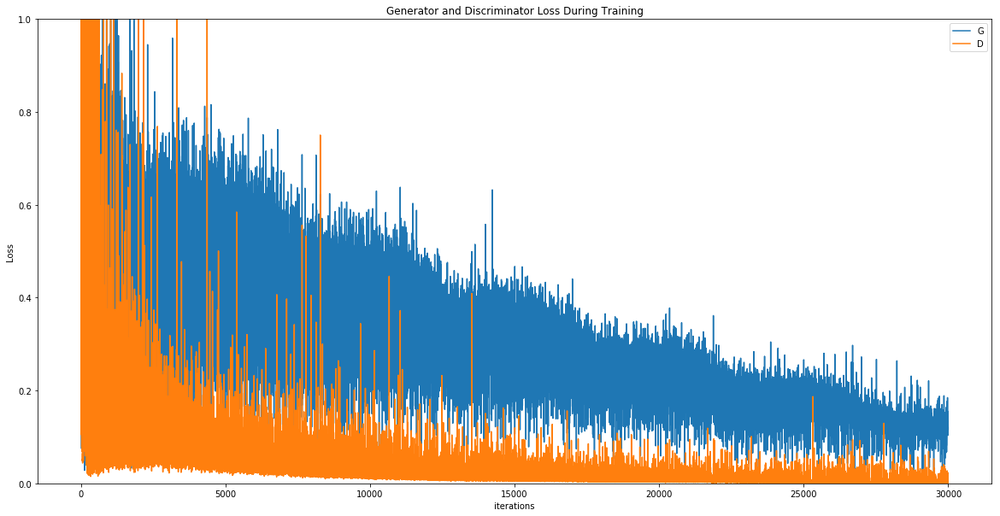

<Figure size 432x288 with 0 Axes>

In [0]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(C_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.ylim(0,1)
plt.legend()
plt.show()
plt.savefig('1.png')

## Results

In [0]:
import matplotlib.animation as animation
from IPython.display import HTML

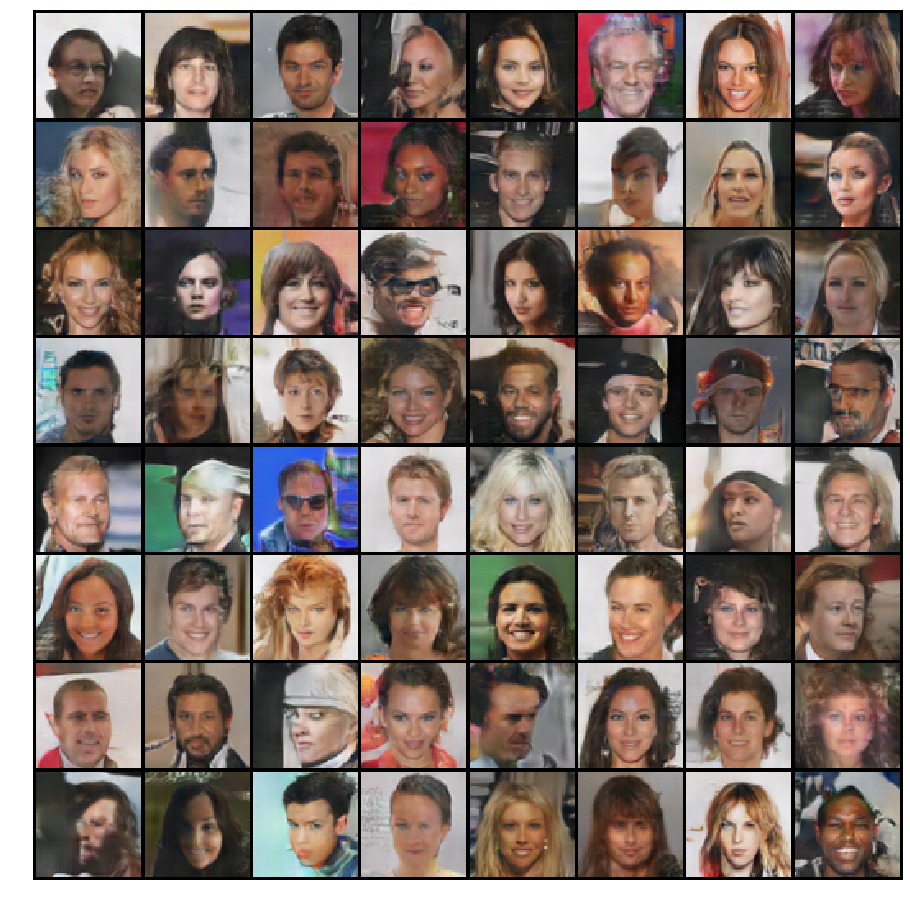

In [0]:
#%%capture
fig = plt.figure(figsize=(16,16))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list[:-20]]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())